## Histogram Interactive

In [59]:
#function  for histogram for customer attrition types

#Separating churn and non churn customers
churn     = data_classification_cl0[data_classification_cl0["Target_by_med"] == 1]
not_churn = data_classification_cl0[data_classification_cl0["Target_by_med"] == 0]


def histogram(column) :
    
    
    trace1 = go.Histogram(x  = not_churn[column],
                          histnorm= "percent",
                          name = "Non Churn Customers",
                          marker = dict(line = dict(width = .5,
                                                    color = "blue"
                                                    )
                                        ),
                         opacity = .9 
                         ) 
    
    trace2 = go.Histogram(x  = churn[column],
                          histnorm = "percent",
                          name = "churn customers",
                          marker = dict(line = dict(width = .5,
                                              color = "red"
                                             )
                                 ),
                          opacity = .9
                         )
    
    data = [trace1,trace2]
    layout = go.Layout(dict(title =column + " distribution in customer attrition in Cluster 0",
                            plot_bgcolor  = "rgb(243,243,243)",
                            paper_bgcolor = "rgb(243,243,243)",
                            xaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                             title = column,
                                             zerolinewidth=1,
                                             ticklen=5,
                                             gridwidth=2
                                            ),
                            yaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                             title = "percent",
                                             zerolinewidth=1,
                                             ticklen=5,
                                             gridwidth=2
                                            ),
                           )
                      )
    fig  = go.Figure(data=data,layout=layout)
    
    py.iplot(fig)

In [60]:
#apply the function
column='max_dist'
hist3=histogram(column)


## Comments

In [61]:
#assess the results ( the prcentage of churn clients that have max distance = 56)
print((len(churn.loc[churn['max_dist'] == 56])/len(churn))*100)

0.8060544799523107


In [62]:
#assess the results ( the prcentage of not_churn clients that have max distance = 31)
print((len(not_churn.loc[not_churn['max_dist'] == 31])/len(not_churn))*100)

2.475287599276842


In [63]:
#apply the function
column='recency'
hist4=histogram(column)


In [64]:
#drop the clients usernames
data_classification_cl0.drop(['client_username_s'], axis=1, inplace=True)

In [65]:
data_classification_cl0.drop(['Cluster'], axis=1, inplace=True)

## Correlation matrix

In [66]:
#correlation
correlation = data_classification_cl0.corr()
#tick labels
matrix_cols = correlation.columns.tolist()
#convert to array
corr_array  = np.array(correlation)

#Plotting
trace = go.Heatmap(z = corr_array,
                   x = matrix_cols,
                   y = matrix_cols,
                   colorscale = "Viridis",
                   colorbar   = dict(title = "Pearson Correlation coefficient",
                                     titleside = "right"
                                    ) ,
                  )

layout = go.Layout(dict(title = "Correlation Matrix for variables in Cluster 0",
                        autosize = False,
                        height  = 720,
                        width   = 800,
                        margin  = dict(r = 0 ,l = 210,
                                       t = 25,b = 210,
                                      ),
                        yaxis   = dict(tickfont = dict(size = 9)),
                        xaxis   = dict(tickfont = dict(size = 9))
                       )
                  )

data = [trace]
fig = go.Figure(data=data,layout=layout)
py.iplot(fig)

# CLUSTER 2

In [67]:
data_classification_cl2['Target_by_med'].value_counts()

1    121484
0     72653
Name: Target_by_med, dtype: int64

In [68]:
print('The no churn clients are '+str(data_classification_cl2['Target_by_med'].value_counts()[0]) +' whereas \nthe churn clients are ' + str(data_classification_cl2['Target_by_med'].value_counts()[1]))


The no churn clients are 72653 whereas 
the churn clients are 121484


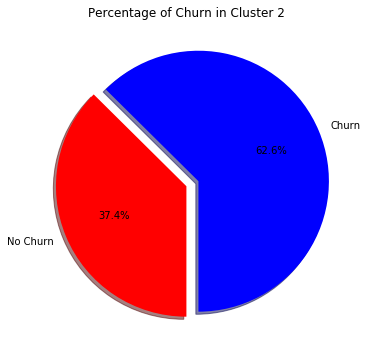

In [105]:
# Data to plot
labels='Churn','No Churn'
explode = (0.1, 0) #0.1 means that we want to be cut off the clice
sizes = data_classification_cl2['Target_by_med'].value_counts(sort = True)
colors = ["blue","red"] 
rcParams['figure.figsize'] = 6,6
# Plot
plt.pie(sizes, explode=explode, labels=labels, colors=colors,
        autopct='%1.1f%%', shadow=True, startangle=270,)
plt.title('Percentage of Churn in Cluster 2')
plt.show()

In [106]:
print ("Rows     : " ,data_classification_cl2.shape[0])
print ("Columns  : " ,data_classification_cl2.shape[1])
print ("\nFeatures : \n" ,data_classification_cl2.columns.tolist())
print ("\nMissing values :  ", data_classification_cl2.isnull().sum().values.sum())
print ("\nUnique values :  \n",data_classification_cl2.nunique())

Rows     :  194137
Columns  :  8

Features : 
 ['countt', 'recency', 'frequency', 'max_dist', 'average_trans_dur', 'diff_maxd_mind_days', 'start_trans_end_data', 'Target_by_med']

Missing values :   0

Unique values :  
 countt                  5982
recency                  410
frequency                252
max_dist                 399
average_trans_dur       3187
diff_maxd_mind_days      437
start_trans_end_data     371
Target_by_med              2
dtype: int64


# Sumary Interactive

In [107]:
summary = (data_classification_cl2.
           describe().transpose().reset_index())

summary = summary.rename(columns = {"index" : "feature"})
summary = np.around(summary,3)

val_lst = [summary['feature'], summary['count'],
           summary['mean'],summary['std'],
           summary['min'], summary['25%'],
           summary['50%'], summary['75%'], summary['max']]

trace  = go.Table(header = dict(values = summary.columns.tolist(),
                                line = dict(color = ['#506784']),
                                fill = dict(color = ['#119DFF']),
                               ),
                  cells  = dict(values = val_lst,
                                line = dict(color = ['#506784']),
                                fill = dict(color = ["lightgrey",'#F5F8FF'])
                               ),
                  columnwidth = [200,60,100,100,60,60,80,80,80])
layout = go.Layout(dict(title = "Summary Table for all variabls-features in Cluster 2"))
figure = go.Figure(data=[trace],layout=layout)
py.iplot(figure)